In [3]:
import pandas as pd
from IPython.core.display import display, HTML
import matplotlib.pyplot as plt
import os
import seaborn as sns
import numpy as np

C:\Users\13042\AppData\Local\Temp\ipykernel_35104\1714515711.py:2: DeprecationWarning: Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display
  from IPython.core.display import display, HTML


### Training/Test split

In [10]:
X_train, X_test, y_train, y_test = train_test_split(X_os, y_os, test_size=0.2, random_state=42)

In [11]:
train_data = pd.concat([X_train, y_train], axis=1)
train_data.to_csv('train_data.csv', index=False)

test_data = pd.concat([X_test, y_test], axis=1)
test_data.to_csv('test_data.csv', index=False)

#### Recursive feature selection

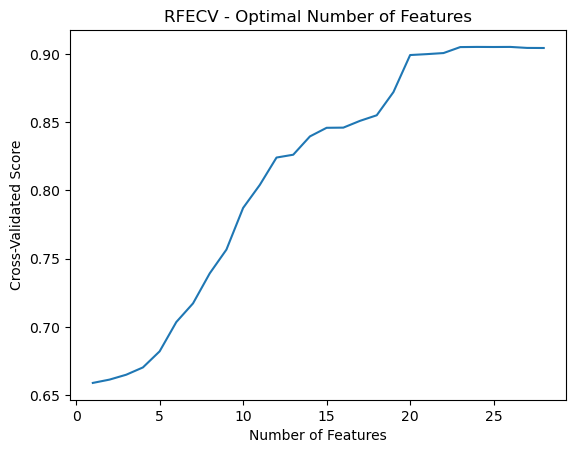

Optimal number of features: 24


In [17]:
from sklearn.feature_selection import RFECV

rfecv = RFECV(estimator=LogisticRegression(solver='newton-cg'), step=1, cv=5, scoring='accuracy')
rfecv.fit(X_train, y_train)

mean_test_scores = rfecv.cv_results_['mean_test_score']

# Plot the number of features vs. cross-validated score
plt.plot(range(1, len(mean_test_scores) + 1), mean_test_scores)
plt.xlabel('Number of Features')
plt.ylabel('Cross-Validated Score')
plt.title('RFECV - Optimal Number of Features')
plt.show()

# Print the optimal number of features
print(f"Optimal number of features: {rfecv.n_features_}")

In [18]:
rfe_selected_columns = X_train.columns[rfecv.support_]
print(rfe_selected_columns)

Index(['Administrative', 'Informational', 'ProductRelated', 'BounceRates',
       'ExitRates', 'PageValues', 'SpecialDay', 'OperatingSystems', 'Region',
       'TrafficType', 'Weekend', 'Month_Aug', 'Month_Dec', 'Month_Feb',
       'Month_Jul', 'Month_June', 'Month_Mar', 'Month_May', 'Month_Nov',
       'Month_Oct', 'Month_Sep', 'VisitorType_New_Visitor',
       'VisitorType_Other', 'VisitorType_Returning_Visitor'],
      dtype='object')


### Anova


Cross-Validated ANOVA F-value Ranking:
PageValues                       3512.970992
ExitRates                        1684.090480
Month_May                        1022.224196
VisitorType_Returning_Visitor     967.970444
BounceRates                       873.932309
Month_Mar                         764.280002
Month_Dec                         554.157225
ProductRelated_Duration           548.212947
ProductRelated                    492.681523
Weekend                           389.960868
OperatingSystems                  373.822449
SpecialDay                        260.052118
Administrative                    247.351323
Administrative_Duration           160.868169
Month_Aug                         114.133107
Month_Feb                         112.633420
Month_June                        111.978503
Month_Jul                         107.672577
Region                            107.309683
Month_Sep                          90.084172
Informational_Duration             78.418455
Month_Oct      

C:\Users\13042\AppData\Local\Temp\ipykernel_35104\2590247415.py:12: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  cum_perc = 100 * cum_sum / cum_sum[-1]


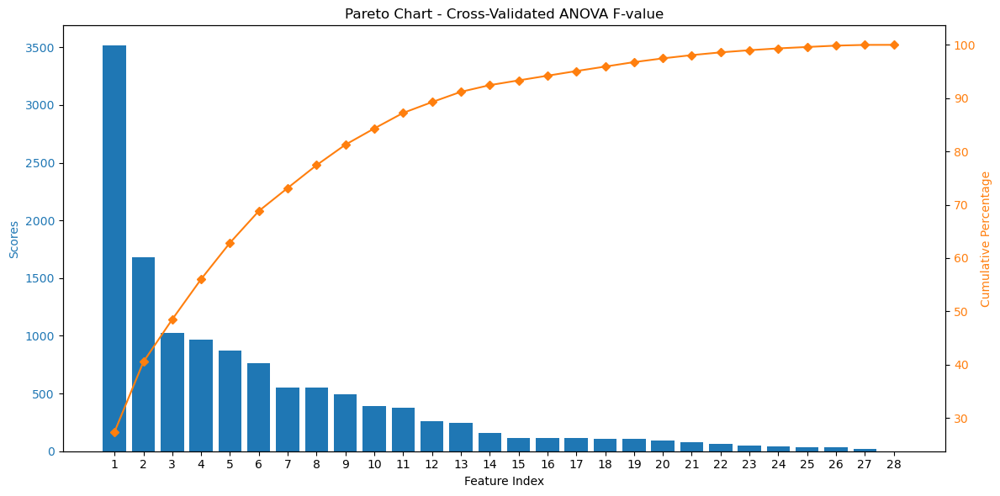

In [19]:
from sklearn.feature_selection import SelectKBest, f_classif
from sklearn.model_selection import StratifiedKFold

def rank_features(scores, feature_names, method_name):
    feature_ranking = pd.Series(scores, index=feature_names)
    feature_ranking = feature_ranking.sort_values(ascending=False)
    print(f"\n{method_name} Ranking:")
    print(feature_ranking)
    
    # Pareto chart
    cum_sum = feature_ranking.cumsum()
    cum_perc = 100 * cum_sum / cum_sum[-1]
    
    indices = range(1, len(feature_ranking) + 1)
    
    fig, ax1 = plt.subplots(figsize=(12, 6))  # Increased figure size for better readability
    
    ax1.bar(indices, feature_ranking.values, color='C0')
    ax1.set_xlabel('Feature Index')
    ax1.set_ylabel('Scores', color='C0')
    ax1.tick_params(axis='y', labelcolor='C0')
    ax1.set_xticks(indices)
    ax1.set_xticklabels(indices)
    
    ax2 = ax1.twinx()
    ax2.plot(indices, cum_perc, color='C1', marker='D', ms=5)
    ax2.set_ylabel('Cumulative Percentage', color='C1')
    ax2.tick_params(axis='y', labelcolor='C1')
    
    plt.title(f'Pareto Chart - {method_name}')
    plt.xticks(rotation=45, ha='right')  # Rotate x-axis labels and align to the right
    plt.tight_layout()  # Adjust layout to prevent clipping of labels
    plt.show()
    return(feature_ranking)
 
def cross_validated_feature_ranking(X, y, k=5):
    skf = StratifiedKFold(n_splits=k)
    feature_scores = np.zeros(X.shape[1])

    for train_index, test_index in skf.split(X, y):
        X_train_cv, X_test_cv = X.iloc[train_index], X.iloc[test_index]
        y_train_cv, y_test_cv = y.iloc[train_index], y.iloc[test_index]
        
        selector_anova = SelectKBest(score_func=f_classif, k='all')
        selector_anova.fit(X_train_cv, y_train_cv)
        feature_scores += selector_anova.scores_
    
    # Average scores over all folds
    feature_scores /= k
    return(rank_features(feature_scores, X.columns, "Cross-Validated ANOVA F-value"))
# Perform cross-validated feature ranking
feature_ranking_anova = cross_validated_feature_ranking(X_train, y_train)

Aqui hay que ponerle un threshold o algo, por la gráfica pareciera que los primeros 22 features están bien

In [20]:
anova_selected_columns = feature_ranking_anova.index[1:22]
print(anova_selected_columns)

Index(['ExitRates', 'Month_May', 'VisitorType_Returning_Visitor',
       'BounceRates', 'Month_Mar', 'Month_Dec', 'ProductRelated_Duration',
       'ProductRelated', 'Weekend', 'OperatingSystems', 'SpecialDay',
       'Administrative', 'Administrative_Duration', 'Month_Aug', 'Month_Feb',
       'Month_June', 'Month_Jul', 'Region', 'Month_Sep',
       'Informational_Duration', 'Month_Oct'],
      dtype='object')


#### Genetic algorithms

A este código le modifiqué el solver del logistic regression y dupliqué max_iter (Línea 150) y ajustes a la función BestIndividual (Línea 78) https://github.com/renatoosousa/GeneticAlgorithmForFeatureSelection

In [ ]:
import deap

python gaFeatureSelection.py path n_population n_generation
We can start with 2 x 31 features for n_population and 10 x 31 n_generation

In [61]:
!python gaFeatureSelection.py train_data.csv 62 310

Accuracy with all features: 	(0.8285887708649469,)

gen	nevals	avg     	min     	max     
0  	62    	0.828653	0.629317	0.882367
1  	35    	0.851429	0.832291	0.882367
2  	33    	0.857222	0.736328	0.882367
3  	31    	0.86365 	0.703187	0.88346 
4  	34    	0.87065 	0.834355	0.884734
5  	33    	0.878104	0.857542	0.884734
6  	39    	0.879754	0.85481 	0.885099
7  	36    	0.881219	0.845038	0.885099
8  	39    	0.882761	0.85827 	0.885888
9  	45    	0.88309 	0.852443	0.893354
10 	35    	0.884185	0.849226	0.892747
11 	30    	0.880492	0.728316	0.892747
12 	44    	0.885939	0.882428	0.892747
13 	40    	0.884181	0.85566 	0.89305 
14 	45    	0.886631	0.859848	0.898877
15 	49    	0.888648	0.866586	0.905372
16 	44    	0.88952 	0.831684	0.905372
17 	21    	0.893105	0.854507	0.905372
18 	39    	0.894439	0.844067	0.905372
19 	36    	0.90022 	0.834112	0.906161
20 	35    	0.900162	0.851897	0.906161
21 	37    	0.902343	0.851533	0.906829
22 	37    	0.900051	0.850197	0.906829
23 	47    	0.904251	0.867982	0.90755

c:\Users\13042\anaconda3\envs\my_env\lib\site-packages\sklearn\linear_model\_logistic.py:469: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
c:\Users\13042\anaconda3\envs\my_env\lib\site-packages\sklearn\linear_model\_logistic.py:469: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logis

    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
c:\Users\13042\anaconda3\envs\my_env\lib\site-packages\sklearn\linear_model\_logistic.py:469: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
c:\Users\13042\anaconda3\envs\my_env\lib\site-packages\sklearn\linear_model\_logistic.py:469: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of i

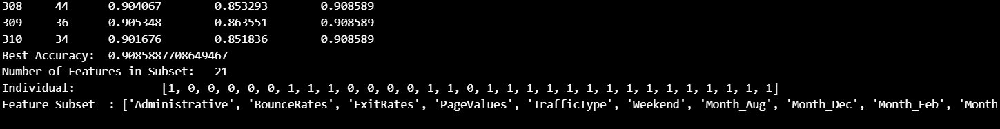

In [30]:
ga_selected_columns = pd.Index(['Administrative', 'BounceRates', 'ExitRates', 'PageValues', 'TrafficType', 'Weekend', 'Month_Aug', 'Month_Dec', 'Month_Feb', 'Month_Jul', 'Month_June', 'Month_Mar', 'Month_May', 'Month_Nov', 'Month_Oct', 'Month_Sep', 'VisitorType_New_Visitor', 'VisitorType_Other', 'VisitorType_Returning_Visitor', 'PageValues_Binned_Zero', 'PageValues_Binned_Positive'])

### Mutual information

In [21]:
from sklearn.feature_selection import mutual_info_classif

mi_scores = mutual_info_classif(X_train, y_train)
top_features_mi = [i for i in sorted(range(len(mi_scores)), key=lambda i: mi_scores[i], reverse=True)[:10]]  # Select top 10

In [26]:
mi_selected_columns = X_train.columns[top_features_mi,]

### Saving Feature selection results

In [28]:
import json

def append_to_json(index, name, file_path='data.json'):
    # Convert index to list if it is a pandas Index object
    if isinstance(index, pd.Index):
        index = index.tolist()
    
    # Create the dictionary to be added to the JSON
    data = {name: index}
    
    try:
        # Try to read the existing data
        with open(file_path, 'r') as file:
            json_data = json.load(file)
    except FileNotFoundError:
        # If the file does not exist, start with an empty dictionary
        json_data = {}

    # Append the new data
    json_data.update(data)
    
    # Write the updated data back to the file
    with open(file_path, 'w') as file:
        json.dump(json_data, file, indent=4)

In [31]:
append_to_json(rfe_selected_columns, "RFE" , "FeatureSelection.json")
append_to_json(anova_selected_columns, "ANOVA" , "FeatureSelection.json")
append_to_json(ga_selected_columns, "GA" , "FeatureSelection.json")
append_to_json(mi_selected_columns, "MI" , "FeatureSelection.json")